In [1]:
# Importage
import warnings
warnings.filterwarnings('ignore')

# os stuff
import os
import sys

import nibabel as nib
from nilearn.plotting import plot_surf, plot_surf_stat_map, plot_roi, plot_anat, plot_surf_roi
from nilearn.image import index_img

import seaborn as sns

# whobpyt stuff
import whobpyt
from whobpyt.data.dataload import dataloader
# from whobpyt.models.jansen_rit import RNNJANSEN
from whobpyt.models.wong_wang import RNNRWW
from whobpyt.datatypes.modelparameters import ParamsModel
from whobpyt.optimization.modelfitting import Model_fitting

# array and pd stuff
import numpy as np
import pandas as pd

# viz stuff
import matplotlib.pyplot as plt

In [76]:
from numpy.polynomial.polynomial import polyfit

In [2]:
from collections import Counter

In [3]:
import seaborn as sns
import scipy.stats as stats

In [4]:
import pickle

In [5]:
parcs = np.arange(0,200,1)

mask = np.tril_indices(len(parcs), -1)

# Labels
_label_file =  '/external/rprshnas01/kcni/hharita/Code/whobpyt/scratch/Schaefer200_7_Ntwx_labels.txt'

f = open(_label_file, "r")
q = f.read()
q = q.rsplit('\n')
# del q[-32:]
labels = q.copy()
labels = np.array(labels)
labels = labels[parcs]


In [255]:
labels

array(['7Networks_LH_Vis_1', '7Networks_LH_Vis_2', '7Networks_LH_Vis_3',
       '7Networks_LH_Vis_4', '7Networks_LH_Vis_5', '7Networks_LH_Vis_6',
       '7Networks_LH_Vis_7', '7Networks_LH_Vis_8', '7Networks_LH_Vis_9',
       '7Networks_LH_Vis_10', '7Networks_LH_Vis_11',
       '7Networks_LH_Vis_12', '7Networks_LH_Vis_13',
       '7Networks_LH_Vis_14', '7Networks_LH_SomMot_1',
       '7Networks_LH_SomMot_2', '7Networks_LH_SomMot_3',
       '7Networks_LH_SomMot_4', '7Networks_LH_SomMot_5',
       '7Networks_LH_SomMot_6', '7Networks_LH_SomMot_7',
       '7Networks_LH_SomMot_8', '7Networks_LH_SomMot_9',
       '7Networks_LH_SomMot_10', '7Networks_LH_SomMot_11',
       '7Networks_LH_SomMot_12', '7Networks_LH_SomMot_13',
       '7Networks_LH_SomMot_14', '7Networks_LH_SomMot_15',
       '7Networks_LH_SomMot_16', '7Networks_LH_DorsAttn_Post_1',
       '7Networks_LH_DorsAttn_Post_2', '7Networks_LH_DorsAttn_Post_3',
       '7Networks_LH_DorsAttn_Post_4', '7Networks_LH_DorsAttn_Post_5',
       '

In [6]:
import re

In [7]:
folder_one_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Shrey_SS_parcellated_Func_Conns_II'
folder_two_path = SCs_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Improved_WWD_HCP_model_runs/All_Subs_SC_Wts/Davide_HCP_Data_Matrix'

# Get the list of files in each folder
folder_one_files = os.listdir(folder_one_path)
folder_two_files = os.listdir(folder_two_path)

# Extract the numbers from the filenames in folder_one
folder_one_numbers = []
for file in folder_one_files:
    match = re.search(r'\d+', file)
    if match:
        folder_one_numbers.append(int(match.group()))

# Extract the numbers from the filenames in folder_two
folder_two_numbers = []
for file in folder_two_files:
    match = re.search(r'\d+', file)
    if match:
        folder_two_numbers.append(int(match.group()))

# Find the common numbers between the two folders
common_numbers = list(set(folder_one_numbers) & set(folder_two_numbers))

sub_list = common_numbers.copy()

sub_list.sort()

sub_list = sub_list[0:200]

In [8]:
pconn_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Shrey_SS_parcellated_Func_Conns_II/'

In [9]:
def emp_fc(sub_id):
    pconn1LR = pconn_path + '{0}_rfMRI_REST1_RL_Schaefer200_cifti_parcellated.ptseries.nii'.format(sub_id)
    pconn_img1LR = nib.load(pconn1LR)
    pconn_dat1LR = pconn_img1LR.get_data()
    pconn_dat1LR = pconn_dat1LR/1
    return pconn_dat1LR

In [10]:
%%time

all_subs_emp_fc = []
for i in range(len(sub_list)):
    ss_emp_fc = emp_fc(sub_list[i])
    all_subs_emp_fc.append(ss_emp_fc)

CPU times: user 1min 1s, sys: 497 ms, total: 1min 2s
Wall time: 1min 19s


In [11]:
%%time
all_subs_emp_fc_mat = []
for i in range(200):
    all_subs_emp_fc_mat.append(np.corrcoef(all_subs_emp_fc[i].T))

CPU times: user 1.37 s, sys: 61.2 ms, total: 1.43 s
Wall time: 1.43 s


In [12]:
og_whobpyt_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/WhoBPyT/200_subjects_WhoBPyT_run'
lesion_whobpyt_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/WhoBPyT/Ntwx_Lesion_WhoBPyT_200_subs'

In [13]:
Wts_Path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/Improved_WWD_HCP_model_runs/All_Subs_SC_Wts/Davide_HCP_Data_Matrix'

In [14]:
def load_wts(sub_id):

    _df = pd.read_csv(Wts_Path + '/{0}/{0}_new_atlas_Yeo.nii.csv'.format(sub_id), delimiter=' ',header=None)
    df_trimmed = _df.iloc[:-31, :-31]
    np_array = df_trimmed.values
    sc_mtx = np_array + np_array.T # --> Symmetric

    pre_laplachian_HCP_SC = sc_mtx.copy()

    SC = pre_laplachian_HCP_SC.copy()
    sc = np.log1p(SC) / np.linalg.norm(np.log1p(SC))
    
    return pre_laplachian_HCP_SC

In [15]:
%%time
all_subs_pre_lap_SC = []

for i in range(len(sub_list)):
    pre_lap_SC = load_wts(sub_list[i])
    all_subs_pre_lap_SC.append(pre_lap_SC)

CPU times: user 7.1 s, sys: 135 ms, total: 7.24 s
Wall time: 14.7 s


In [16]:
%%time

all_subs_og_whobpyt = []
all_subs_vis_lesion = []
all_subs_smt_lesion = []
all_subs_dan_lesion = []
all_subs_van_lesion = []
all_subs_lim_lesion = []
all_subs_fpn_lesion = []
all_subs_dmn_lesion = []

for i in range(len(sub_list)):
    
    sub_id = sub_list[i]
    
    ss_og_whobpyt = np.loadtxt(og_whobpyt_path + '/{0}_whobypt_fc_mtx.txt'.format(sub_id))
    all_subs_og_whobpyt.append(ss_og_whobpyt)
    
    ss_vis_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_vis_lesion_fc_con_mat.txt'.format(sub_id))
    all_subs_vis_lesion.append(ss_vis_lesion)
    

    ss_smt_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_sommot_lesion_fc_con_mat.txt'.format(sub_id))
    all_subs_smt_lesion.append(ss_smt_lesion)

    ss_dan_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_dorsattn_lesion_fc_con_mat.txt'.format(sub_id))
    all_subs_dan_lesion.append(ss_dan_lesion)
    

    ss_van_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_ventattn_lesion_fc_con_mat.txt'.format(sub_id))
    all_subs_van_lesion.append(ss_van_lesion)

    
    ss_lim_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_limbic_lesion_fc_con_mat.txt'.format(sub_id))
    all_subs_lim_lesion.append(ss_lim_lesion)

    
    ss_fpn_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_fpn_lesion_fc_con_mat.txt'.format(sub_id))
    all_subs_fpn_lesion.append(ss_fpn_lesion)

    
    ss_dmn_lesion = np.loadtxt(lesion_whobpyt_path + '/Subj_{0}_dmn_lesion_fc_con_mat.txt'.format(sub_id))
    all_subs_dmn_lesion.append(ss_dmn_lesion)


CPU times: user 1min 44s, sys: 2.68 s, total: 1min 47s
Wall time: 4min 2s


In [75]:
mask = np.tril_indices(200, -1)

In [ ]:
corrs_list = []
for i in range(len(sub_list)):
    ss_corr = np.corrcoef(all_subs_emp_fc_mat[i][mask], all_subs_og_whobpyt[i][mask])[0][1]
    corrs_list.append(ss_corr)

In [320]:
print(np.mean(corrs_list))

0.6076750252186529


In [321]:
print(np.std(corrs_list))

0.051028042572499877


In [322]:
print(np.min(corrs_list))

0.49013224571295294


In [323]:
print(np.max(corrs_list))

0.7374194244219163


In [91]:
# filtered_values = [x for x in corrs_list if x >= 0.6]
indices = [i for i, x in enumerate(corrs_list) if x >= 0.6]

### Figure 2 - Goodness of Fit

### FC

In [115]:
vmaxed = 0.5
vmaxed2 = 0.5

In [116]:
small_sub_list = [60,80,140]
# [60, 80, 90, 110, 120, 140, 170, 180, 190]

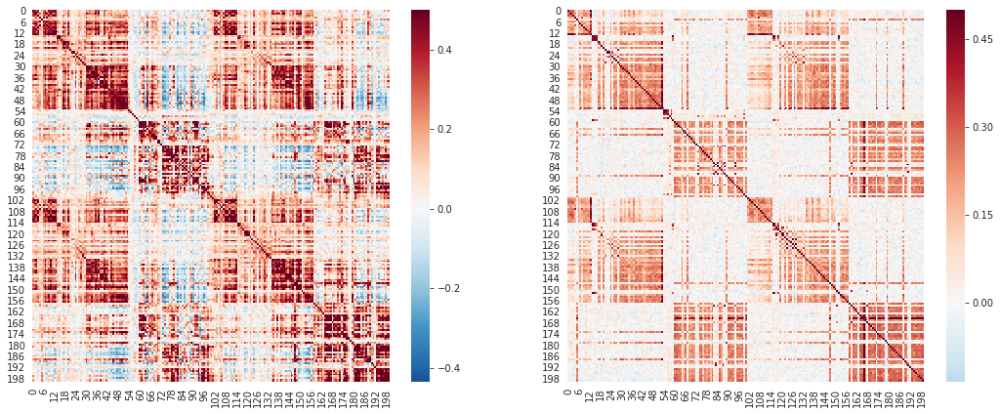

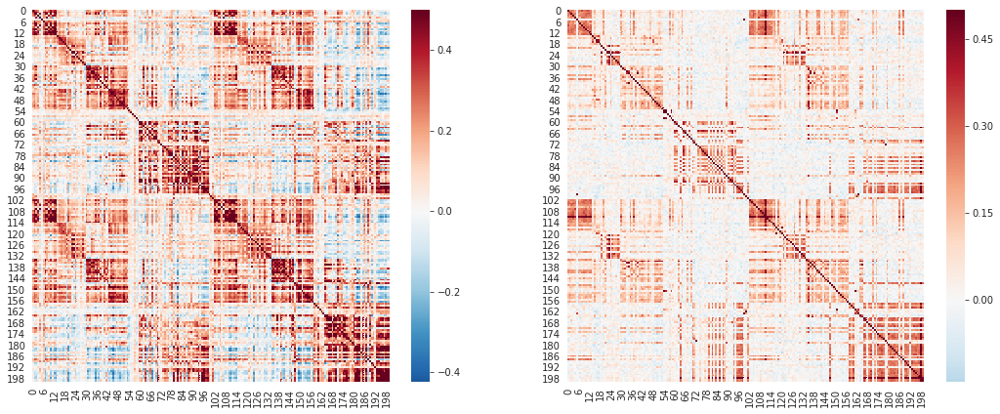

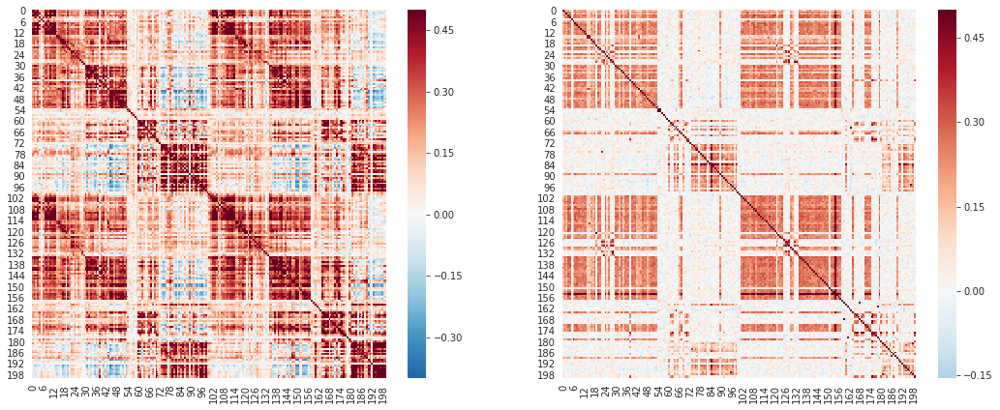

In [117]:
for i in range(len(small_sub_list)):
    fig, ax = plt.subplots(ncols = 2, figsize=(18,7))
    ax = ax.ravel()
    sns.heatmap(all_subs_emp_fc_mat[small_sub_list[i]], cmap='RdBu_r',center=0,vmax=vmaxed,ax=ax[0])
    sns.heatmap(all_subs_og_whobpyt[small_sub_list[i]], cmap='RdBu_r',center=0,vmax=vmaxed2,ax=ax[1])

#### Scatter Plots

In [122]:
print(corrs_list[60])
print(corrs_list[80])
print(corrs_list[140])

0.6183131377408322
0.6140149431713203
0.6479346668411243


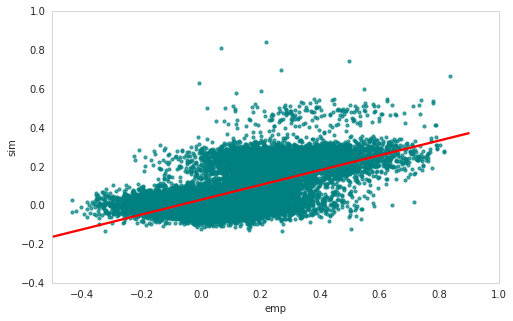

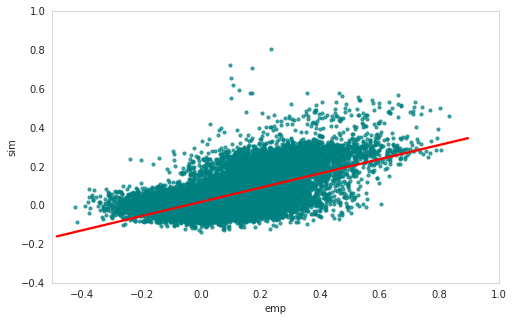

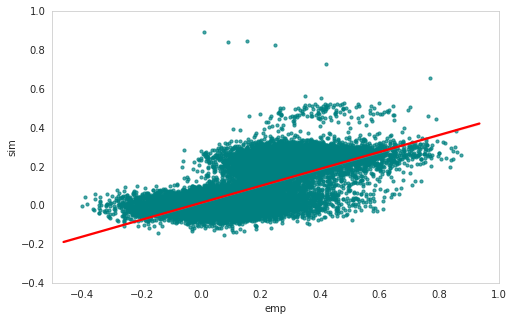

In [319]:
for i in range(len(small_sub_list)):
    sub = small_sub_list[i]
    rww_test = all_subs_og_whobpyt[sub][mask].flatten()

    rww_test2 = all_subs_emp_fc_mat[sub][mask].flatten()

    m, b = np.polyfit(rww_test, rww_test2, 1)

    sns.set_style('whitegrid')
    fig,ax = plt.subplots(figsize=(8,5))
    sns.regplot(rww_test2, rww_test,scatter_kws={'color': 'teal', 's': 10, 'alpha': 0.7},line_kws={'color': 'red'})
    ax.set_xlabel('emp')
    ax.set_ylabel('sim')
    plt.grid(visible=False)
    plt.ylim([-0.4,1])
    plt.xlim([-0.5,1])
    plt.show()

#### Histograms

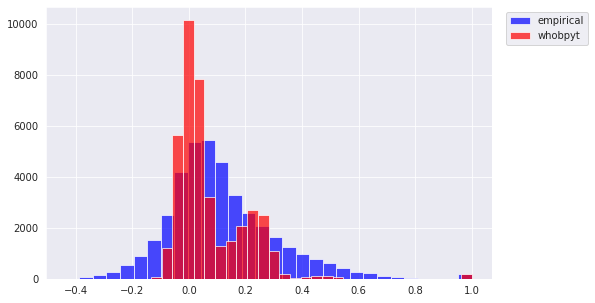

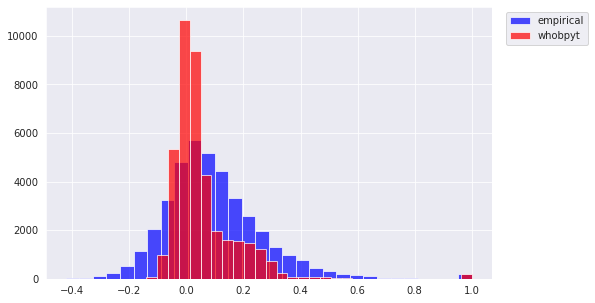

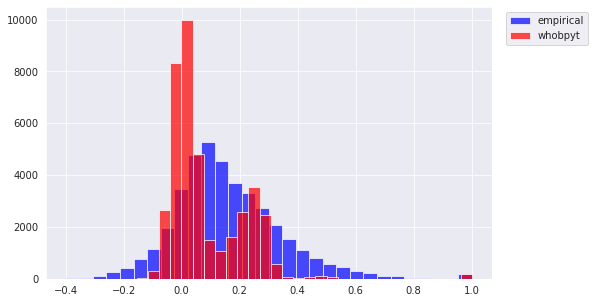

In [317]:
for i in range(len(small_sub_list)):
    sub = small_sub_list[i]
    fig,ax = plt.subplots(figsize=(8,5))
    sns.set_style("darkgrid")

    plt.hist(all_subs_emp_fc_mat[sub].flatten(),bins=30,color='blue',alpha=0.7,label='empirical')
    plt.hist(all_subs_og_whobpyt[sub].flatten(),bins=30,color='red',alpha=0.7,label='whobpyt')
    ax.legend(loc='upper left', bbox_to_anchor=(1.02, 1))
    plt.show()

#### Cortical surface maps

In [282]:
%%time
# Load on surfaces ...

data_direc = '/nethome/kcni/hharita/Data/HCP_WB_Tutorial_TEST/HCP_WB_Tutorial_1.0'

# Left Hemisphere MID-THICKNESS Surface file
mtleft_file = data_direc + '/Q1-Q6_R440.L.midthickness.32k_fs_LR.surf.gii'

# Left Hemisphere INFLATED Surface file
infleft_file = data_direc + '/Q1-Q6_R440.L.inflated.32k_fs_LR.surf.gii'

# Left Hemisphere VERY INFLATED Surface file 
vinfleft_file = data_direc + '/Q1-Q6_R440.L.very_inflated.32k_fs_LR.surf.gii'

# Left Hemisphere PIAL Surface file
pialleft_file = data_direc + '/Q1-Q6_R440.L.pial.32k_fs_LR.surf.gii'

# right Hemisphere MID-THICKNESS Surface file
mtright_file = data_direc + '/Q1-Q6_R440.R.midthickness.32k_fs_LR.surf.gii'

# right Hemisphere INFLATED Surface file
infright_file = data_direc + '/Q1-Q6_R440.R.inflated.32k_fs_LR.surf.gii'

# right Hemisphere VERY INFLATED Surface file 
vinfright_file = data_direc + '/Q1-Q6_R440.R.very_inflated.32k_fs_LR.surf.gii'

# right Hemisphere PIAL Surface file
pialright_file = data_direc + '/Q1-Q6_R440.R.pial.32k_fs_LR.surf.gii'

# for the cifti-2 converted label file
anotherdir = '/external/rprshnas01/kcni/hharita/Data/HCP_WB_Tutorial_TEST/HCP_WB_Tutorial_1.0'
label_file = anotherdir + '/parcellations_VGD11b.32k_fs_LR_c2.dlabel.nii'

# %%time
# read in the loaded surfaces ...

# Mid-thickness surface
img_mt = nib.load(mtleft_file) 
mt_vtx = img_mt.darrays[0].data
mt_tri = img_mt.darrays[1].data

# Pial surface
img_pial = nib.load(pialleft_file)
pial_vtx = img_pial.darrays[0].data
pial_tri = img_pial.darrays[1].data

# Inflated surface
img_inf = nib.load(infleft_file)
inf_vtx = img_inf.darrays[0].data
inf_tri = img_inf.darrays[1].data

# Inflated surface
img_vinf = nib.load(vinfleft_file)
vinf_vtx = img_vinf.darrays[0].data
vinf_tri = img_vinf.darrays[1].data

# mid-thickness
df_mt_vtx = pd.DataFrame(mt_vtx, columns=['x','y','z'])

# pial
df_pial_vtx = pd.DataFrame(pial_vtx, columns=['x','y','z'])

# inflated 
df_inf_vtx = pd.DataFrame(inf_vtx, columns=['x','y','z'])

# very inflated
df_vinf_vtx = pd.DataFrame(vinf_vtx, columns=['x','y','z'])

# %%time
# read in the loaded surfaces ...

# Mid-thickness surface
r_img_mt = nib.load(mtright_file) 
r_mt_vtx = r_img_mt.darrays[0].data
r_mt_tri = r_img_mt.darrays[1].data

# Pial surface
r_img_pial = nib.load(pialright_file)
r_pial_vtx = r_img_pial.darrays[0].data
r_pial_tri = r_img_pial.darrays[1].data

# Inflated surface
r_img_inf = nib.load(infright_file)
r_inf_vtx = r_img_inf.darrays[0].data
r_inf_tri = r_img_inf.darrays[1].data

# Inflated surface
r_img_vinf = nib.load(vinfright_file)
r_vinf_vtx = r_img_vinf.darrays[0].data
r_vinf_tri = r_img_vinf.darrays[1].data

# mid-thickness
r_df_mt_vtx = pd.DataFrame(r_mt_vtx, columns=['x','y','z'])

# pial
r_df_pial_vtx = pd.DataFrame(r_pial_vtx, columns=['x','y','z'])

# inflated 
r_df_inf_vtx = pd.DataFrame(r_inf_vtx, columns=['x','y','z'])

# very inflated
r_df_vinf_vtx = pd.DataFrame(r_vinf_vtx, columns=['x','y','z'])

# %%time

# Pial surface --> RIGHT hemisphere ...
img_pial_rh = nib.load(pialright_file)
pial_vtx_rh = img_pial_rh.darrays[0].data
pial_tri_rh = img_pial_rh.darrays[1].data

xr,yr,zr = pial_vtx_rh.T
x,y,z = pial_vtx.T

# # %%time
# # Load the dconn file like previous NBs
# dconn_file = '/nethome/kcni/hharita/Data/HCP_1200/HCP_S1200_1003_rfMRI_MSMAll_groupPCA_d4500ROW_zcorr.dconn.nii'
# dconn_img = nib.load(dconn_file)
# dconn_dat = dconn_img.get_data()
# dconn_hdr = dconn_img.header
# dconn_ax0 = dconn_hdr.get_axis(0)
# dconn_ax1 = dconn_hdr.get_axis(1)

cbig_dir = '/external/rprshnas01/netdata_kcni/jglab/Code/libraries_of_others/github/CBIG'

# Load in 1000 parcellation variant of Schaefer parcellations label file ...
sch200lab_file = cbig_dir + '/stable_projects/brain_parcellation/Schaefer2018_LocalGlobal/Parcellations/HCP/fslr32k/cifti/Schaefer2018_200Parcels_7Networks_order.dlabel.nii'
sch200lab_img = nib.load(sch200lab_file)
sch200lab_dat = np.squeeze(sch200lab_img.get_data())
schaefer_parc = sch200lab_dat.copy()
sch200lab_ax0 = sch200lab_img.header.get_axis(0)
sch200lab_ax1 = sch200lab_img.header.get_axis(1)

dat_lh = sch200lab_dat[0:mt_vtx.shape[0]]


dat_rh = sch200lab_dat[32492:64984]

# Code courtesy JG ...
# Compute dconn-to-gifti surface mapping ...

# lh_idxs,rh_idxs= [],[]
# for a_it in range(0,dconn_ax1.size):
#     el = dconn_ax1.get_element(a_it)
#     if el[2] == 'CIFTI_STRUCTURE_CORTEX_LEFT':
#         lh_idxs.append([a_it,el[1]])
#     elif el[2] == 'CIFTI_STRUCTURE_CORTEX_RIGHT':        
#         rh_idxs.append([a_it,el[1]])
# lh_idxs = np.array(lh_idxs)
# rh_idxs = np.array(rh_idxs)

pixdim[1,2,3] should be non-zero; setting 0 dims to 1


CPU times: user 915 ms, sys: 16.2 ms, total: 931 ms
Wall time: 1.02 s


In [283]:
actual_dat_lh = np.arange(1,101)

actual_dat_rh = np.arange(101,201)

In [284]:
# %%time
lh_patch_idxs = []
for i in range(len(actual_dat_lh)):
    patch_val = actual_dat_lh[i]
    patch_idx = np.nonzero(dat_lh==patch_val)[0] #np.nonzero returns the indices of the elements that are non-zero.
    lh_patch_idxs.insert(i,patch_idx)

len(lh_patch_idxs)


# %%time
rh_patch_idxs = []
for i in range(len(actual_dat_rh)):
    patch_val = actual_dat_rh[i]
    patch_idx = np.nonzero(dat_rh==patch_val)[0] #np.nonzero returns the indices of the elements that are non-zero.
    rh_patch_idxs.insert(i,patch_idx)

len(rh_patch_idxs)

100

In [285]:
lh_idxs = np.loadtxt('lh_idxs.txt')
rh_idxs = np.loadtxt('rh_idxs.txt')

In [286]:
def lh_new_surf_for_neg_fc(Neg_FC, region_idx):
    new_surf = []
    NegFC_region = Neg_FC[region_idx][0:100]
    region_new_surf = np.zeros(inf_vtx.shape[0])
    for i in range(len(NegFC_region)):
        region_new_surf[lh_patch_idxs[i]] = NegFC_region[i]
    new_surf =  region_new_surf.copy()
    return new_surf

In [287]:
def rh_new_surf_for_neg_fc(Neg_FC, region_idx):
    new_surf = []
    NegFC_region = Neg_FC[region_idx][100:200]
    region_new_surf = np.zeros(r_inf_vtx.shape[0])
    for i in range(len(NegFC_region)):
        region_new_surf[rh_patch_idxs[i]] = NegFC_region[i]
    new_surf =  region_new_surf.copy()
    return new_surf

In [288]:
from nilearn.plotting import view_surf

from IPython.display import display

from numpy.polynomial.polynomial import polyfit

In [289]:
# all_subs_og_whobpyt
# all_subs_emp_fc_mat

In [290]:
labels[73:100]

array(['7Networks_LH_Default_Temp_1', '7Networks_LH_Default_Temp_2',
       '7Networks_LH_Default_Temp_3', '7Networks_LH_Default_Temp_4',
       '7Networks_LH_Default_Temp_5', '7Networks_LH_Default_Par_1',
       '7Networks_LH_Default_Par_2', '7Networks_LH_Default_Par_3',
       '7Networks_LH_Default_Par_4', '7Networks_LH_Default_PFC_1',
       '7Networks_LH_Default_PFC_2', '7Networks_LH_Default_PFC_3',
       '7Networks_LH_Default_PFC_4', '7Networks_LH_Default_PFC_5',
       '7Networks_LH_Default_PFC_6', '7Networks_LH_Default_PFC_7',
       '7Networks_LH_Default_PFC_8', '7Networks_LH_Default_PFC_9',
       '7Networks_LH_Default_PFC_10', '7Networks_LH_Default_PFC_11',
       '7Networks_LH_Default_PFC_12', '7Networks_LH_Default_PFC_13',
       '7Networks_LH_Default_pCunPCC_1', '7Networks_LH_Default_pCunPCC_2',
       '7Networks_LH_Default_pCunPCC_3', '7Networks_LH_Default_pCunPCC_4',
       '7Networks_LH_Default_PHC_1'], dtype='<U37')

#### Identifying PCC parcellations

In [318]:
parc = 96
lh_emp_ntwx_roi = lh_new_surf_for_neg_fc(all_subs_emp_fc_mat[60], parc)
print(labels[parc])
lh_emp_tmp = lh_emp_ntwx_roi.copy()
emp_disp_lh = view_surf([pial_vtx,pial_tri], lh_emp_tmp ,cmap='RdBu_r', vmax=0.5,vmin=-0.5, symmetric_cmap=True,threshold=0.9)#, threshold=0.1)

display(emp_disp_lh)


7Networks_LH_Default_pCunPCC_2


### Subj 1 - left hemisphere

#### empirical

In [324]:
parc = 96
lh_emp_ntwx_roi = lh_new_surf_for_neg_fc(all_subs_emp_fc_mat[60], parc)
print(labels[parc])
lh_emp_tmp = lh_emp_ntwx_roi.copy()
emp_disp_lh = view_surf([pial_vtx,pial_tri], lh_emp_tmp ,cmap='RdBu_r', vmax=0.5,vmin=-0.5, symmetric_cmap=True)#, threshold=0.1)

display(emp_disp_lh)


7Networks_LH_Default_pCunPCC_2


#### whobpyt

In [330]:
parc = 96
lh_emp_ntwx_roi = lh_new_surf_for_neg_fc(all_subs_og_whobpyt[60], parc)
print(labels[parc])
lh_emp_tmp = lh_emp_ntwx_roi.copy()
emp_disp_lh = view_surf([pial_vtx,pial_tri], lh_emp_tmp ,cmap='RdBu_r', vmax=0.2,vmin=-0.1, symmetric_cmap=True)#, threshold=0.1)

display(emp_disp_lh)


7Networks_LH_Default_pCunPCC_2


### Subj 2 - left hemisphere

####  empirical

In [327]:
parc = 96
lh_emp_ntwx_roi = lh_new_surf_for_neg_fc(all_subs_emp_fc_mat[140], parc)
print(labels[parc])
lh_emp_tmp = lh_emp_ntwx_roi.copy()
emp_disp_lh = view_surf([pial_vtx,pial_tri], lh_emp_tmp ,cmap='RdBu_r', vmax=0.5,vmin=-0.5, symmetric_cmap=True)#, threshold=0.1)

display(emp_disp_lh)


7Networks_LH_Default_pCunPCC_2


#### whobpyt

In [329]:
parc = 96
lh_emp_ntwx_roi = lh_new_surf_for_neg_fc(all_subs_og_whobpyt[140], parc)
print(labels[parc])
lh_emp_tmp = lh_emp_ntwx_roi.copy()
emp_disp_lh = view_surf([pial_vtx,pial_tri], lh_emp_tmp ,cmap='RdBu_r', vmax=0.2,vmin=-0.1, symmetric_cmap=True)#, threshold=0.1)

display(emp_disp_lh)


7Networks_LH_Default_pCunPCC_2


### Subj 2 - right hemisphere

#### empirical

In [331]:
parc = 96
rh_emp_ntwx_roi = rh_new_surf_for_neg_fc(all_subs_emp_fc_mat[140], parc)
print(labels[parc])
rh_emp_tmp = rh_emp_ntwx_roi.copy()
emp_disp_rh = view_surf([r_pial_vtx,r_pial_tri], rh_emp_tmp ,cmap='RdBu_r', vmax=0.5,vmin=-0.5, symmetric_cmap=True)#, threshold=0.1)

display(emp_disp_rh)


7Networks_LH_Default_pCunPCC_2


#### whobpyt

In [332]:
parc = 96
rh_emp_ntwx_roi = rh_new_surf_for_neg_fc(all_subs_og_whobpyt[140], parc)
print(labels[parc])
rh_emp_tmp = rh_emp_ntwx_roi.copy()
emp_disp_rh = view_surf([r_pial_vtx,r_pial_tri], rh_emp_tmp ,cmap='RdBu_r', vmax=0.2,vmin=-0.1, symmetric_cmap=True)#, threshold=0.1)

display(emp_disp_rh)


7Networks_LH_Default_pCunPCC_2


### SC

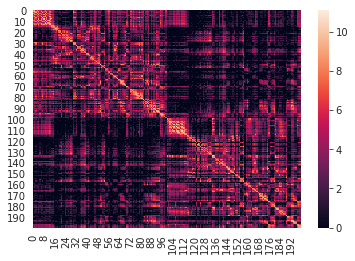

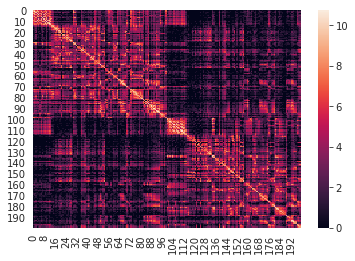

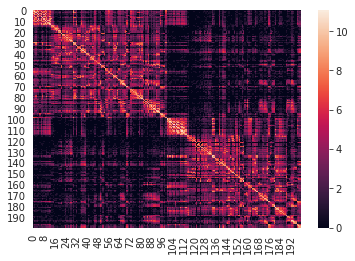

In [187]:
for i in range(len(small_sub_list)):
    sub = small_sub_list[i]
    fig,ax = plt.subplots()
    sns.heatmap((np.log1p(all_subs_pre_lap_SC[sub])))

In [145]:
data_path = '/external/rprshnas01/netdata_kcni/jglab/MemberSpaces/Data/Shrey/WhoBPyT/200_subjects_WhoBPyT_run_pkls'

In [146]:
%%time
small_subs_pkls = []
for i in range(len(small_sub_list)):
    sub_id = sub_list[small_sub_list[i]]
    filename = data_path + '/Subj_{0}_fittingresults_stim_exp.pkl'.format(sub_id)
    with open(filename, 'rb') as f:
        ss_og_data = pickle.load(f)
        small_subs_pkls.append(ss_og_data)
    

CPU times: user 504 ms, sys: 1.86 s, total: 2.36 s
Wall time: 16 s


In [152]:
# sns.heatmap(np.corrcoef(small_subs_pkls[0].output_sim.bold_test),cmap='RdBu_r',center=0,vmax=vmaxed)

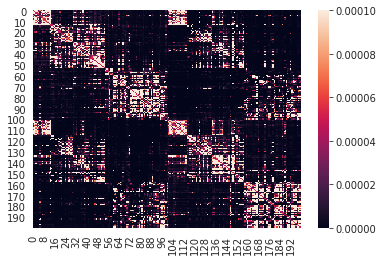

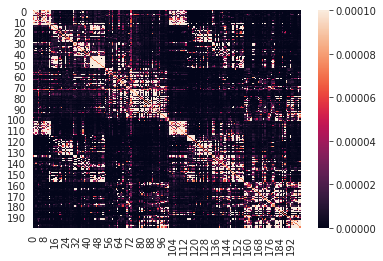

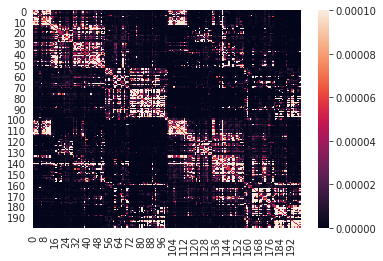

In [183]:
for i in range(3):
    fig,ax = plt.subplots()
    sns.heatmap(small_subs_pkls[i].model.sc_fitted.detach().numpy(),vmax=0.0001)